# Detection of SQL Injection Queries
### Introduction

SQL (Structured Query Language) is heavily used in the realm of database management systems. A wide variety of softwares use databases in their backend and the software programs use SQL queries to fetch and write data to those databases of information. SQL is extremely efficient, fast and very easy to learn and use. However, since the 1990s, there has been public discussion about cybercrimes called SQL Injection Attacks (or SQLIAs), specifically taking advantage of SQL's vulnerabilities. (https://en.wikipedia.org/wiki/SQL_injection). These attacks have lead to multiple problems like invasion of privacy, destructive manipulation of data and even complete deletion of the database, costing both the consumers and producers of software products.
Hence it is imperative to be able to prevent SQLIAs as aggressively as possible, and there are a number of ways to do so:
1. Writing code to ensure SQLIA queries do not reach the database and can be denied access by the program itself. e.g. keeping a simple if statement in a login form to check if input given is a proper string and not manipulated, using parameterized statements rather than simple strings, using optimized frameworks like Django which have various types of security checks including SQLIAs.
2. Monitoring the source IPs of incoming requests and checking for suspicious activities.
3. Denying permission for certain queries to the database using Access Control Lists.

### Why use machine learning to solve this problem?

SQLIAs occur over a wide spectrum of scenarios owing to the popularity of SQL as a querying language. As such, there are numerous types of SQLIAs that need to be taken care of. A developer has to be extremely cautious and be able to foresee various SQLIA types to hard code all the possible test cases.
Machine learning can often provide a good solution when the problem is too complex to be solved by hard-coding. In this case too, a robust ML model that has been trained on all sorts of SQLIAs can be expected to perform well.

Also, different types of SQLIAs can happen in different software systems. What works in one may not work for another. Hence the developer needs to find the specifics of that individual software and write the code accordingly. A general ML model trained on different types of SQLIAs can be used irrespective of what type of software is using it.

Over time, SQLI attacks have changed. Cybercriminals come up with new and more sophisticated techniques to attack your system. Updating the code after discovering such techniques or relying on some other framework to take care of it may not be enough to prevent such attacks. A well-trained ML model may be able to predict and come up with new checks to deal with new unseen queries, as they can learn the patterns which are hidden to humans.

To summarize, SQLI attacks can be extremely devastating and it is important to prevent them from happening. Machine learning models can help in this regard by learning from a variety of such attacks and gain the intelligence to detect them. A generalized ML model can work across all types of software systems. ML models can adapt over time and identify the patterns of SQLI attacks and prevent them from happening in the future.

### Problem Statement

#### Dataset

The dataset consists of 30K+ SQL queries, labelled as SQLIA or normal.

#### ML Problem Statement

Given the dataset, our task is to build a model that classifies new SQL queries as SQLIA or normal to a high degree of accuracy. (Classification Task)

### Importing libraries

In [3]:
import numpy as np
import pandas as pd

# for creating all the plots of features generated and target variable
import plotly.express as px

# for computing bag of words, tf-idf embeddings 
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# for sentiment polarity, POS tagging and scatter plot visualization of texts
import spacy
from spacytextblob.spacytextblob import SpacyTextBlob
import scattertext as st

# for parsing sql queries and get more information
import sqlparse

# for finding specific string patters in SQL queries
import re

# for interaction with os, for dumping/fetching files
import os.path
import json

# for entropy calculations
from collections import Counter

# for calculating entropy, likelihood ratios and their percentiles
import math
from scipy.stats import percentileofscore

# for glove vector representations of the sql query tokens
import gensim.downloader

# for 2D visualization of query vector embeddings
from sklearn.manifold import TSNE

### Fetching Dataset

In [4]:
DATASET_PATH = 'sql-injection-dataset/Modified_SQL_Dataset.csv'
data = pd.read_csv(DATASET_PATH) # reading data file

### Basic Data Analysis

In [5]:
print("Shape:", data.shape)
print("Columns:", data.columns.values)

Shape: (30919, 2)
Columns: ['Query' 'Label']


The dataset has 30.9K queries. It has 2 columns.

- 'Query': SQL query
- 'Label': 1 if query is SQLIA else 0

In [6]:
data.head() # first 5 rows

,Query,Label
0,""" or pg_sleep ( __TIME__ ) --",1
1,create user name identified by pass123 tempora...,1
2,AND 1 = utl_inaddr.get_host_address ( ...,1
3,select * from users where id = '1' or @ @1 ...,1
4,"select * from users where id = 1 or 1#"" ( ...",1


In [7]:
data.tail() # last 5 rows

,Query,Label
30914,DELETE FROM door WHERE grow = 'small',0
30915,DELETE FROM tomorrow,0
30916,SELECT wide ( s ) FROM west,0
30917,SELECT * FROM ( SELECT slide FROM breath ),0
30918,SELECT TOP 3 * FROM race,0


In [8]:
data.describe() # description of 'Label' column

,Label
count,30919.000000
mean,0.368123
std,0.482303
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,1.000000


- Since the mean is less than 0.5, we know that there are less SQLIA queries than normal queries.

In [9]:
data.describe(include=['O']) # description of 'Query' column

,Query
count,30919
unique,30905
top,#NAME?
freq,8


##### Dropping empty query

In [10]:
for i in range(data.shape[0]):
    if data['Query'].iloc[i].strip() == "":
        print("Index", i, "has an empty query")

Index 19323 has an empty query


In [11]:
data.drop(labels=19323, inplace=True)

### Is dataset imbalanced?

In [12]:
# checking %ge of values in each category
data['Label'].value_counts()/data.shape[0] * 100

0    63.189728
1    36.810272
Name: Label, dtype: float64

Only 1/3rd of the queries have Label=1. So the dataset is imbalanced.

In [13]:
# Normal queries
data[data['Label']==0].head(10)

,Query,Label
11330,99745017c,0
11331,ejerci78,0
11332,47209,0
11333,"calle valencia de don juan 161, 7?d",0
11334,b3r3al,0
11335,46942381w,0
11336,elder@parcalia.hn,0
11337,24596413y,0
11338,compte,0
11339,2366,0


In [14]:
# SQLIA queries

data[data['Label']==1].head(10)

,Query,Label
0,""" or pg_sleep ( __TIME__ ) --",1
1,create user name identified by pass123 tempora...,1
2,AND 1 = utl_inaddr.get_host_address ( ...,1
3,select * from users where id = '1' or @ @1 ...,1
4,"select * from users where id = 1 or 1#"" ( ...",1
5,select name from syscolumns where id = ...,1
6,select * from users where id = 1 +$+ or 1 =...,1
7,"1; ( load_file ( char ( 47,101,116,99,47...",1
8,select * from users where id = '1' or ||/1 ...,1
9,select * from users where id = '1' or \.<\ ...,1


# Choosing the Key Performance Metric

### From data analysis of target variable

We have the following conclusions based on above analysis:

1. The target variable, 'Label' is a binary variable with values 0 and 1. 
2. The dataset is imbalanced - only 1/3rd of the queries are SQLIA.

### From business requirement

Our business requirement is to come up with a model that detects SQLIA. As discussed, if a SQLIA query goes undetected, it can lead to heavy losses on a business and its customers. On the other hand, it is also important that a non-SQLIA query is not misclassified as SQLIA as this would lead to customers not getting the service from the business. Ideally, we would want a model that can take care of both classifying SQLIAs and non-SQLIAs perfectly. Since that is not how real-world applications work, we need to prioritize.

An undetected SQLIA can cause permanent havoc to the business and its entire customer base, whereas a misclassified non-SQLIA may cause issues for a smaller percentage of customers.

### Thresholding

We want a model that outputs probabilities rather than absolute values. E.g. output = 0.6 means there is 60% probability of the query being SQLIA. This means, for the final classification, we have to choose a threshold. As we want to give more weightage to positive labels (SQLIA), we must set a threshold lower than 0.5.

### Key Performance Metric

Based on the above points, we need to come up with a metric that can meet the following criteria:
1. Handles imbalanced data well
2. Tries to minimize misclassification of both positive and negative labels, but gives more preference to classifying positive labels better.
3. Gives flexibility to choose a threshold.

A metric that follows all the above criteria is F1 score.

#### Why not accuracy?

- Accuracy does not take into account the probabilities given by the model. It only cares about the counts.
- Accuracy does not work well for imbalanced data.
- Accuracy treats positive and negative labels equally.

#### Why not ROC-AUC score?

- ROC-AUC score treats positive and negative labels equally. So it won't give more preference to SQLIA queries.
- With ROC-AUC score, we don't have the option of choosing a best threshold for our problem. A high ROC-AUC score reflects a model that can perform well on an average for the entire range of threshold values.

#### Why not log-loss?

- Log-loss measures the misclassifications by taking into account how confident the model is of its prediction. Just like accuracy measures the discrete count of misclassifications, log-loss measures the confidence of predictions of labels. As such, it does not care about positive and negative labels and treats them equally.
- Like accuracy, log-loss also does not work well for imbalanced data.

#### Why F1 score?

F1 score = (precision * recall) / (precision + recall)

- F1 score takes into account precision and recall.
    - Precision = Out of all points predicted as positive, how many are actually positive?
    - Recall = Out of all positive points, how many were predicted as positive?
    With these values, F1 score cares about minimizing:
    - %ge of misclassified positive predictions (precision)
    - %ge of misclassified true positives (recall)
    F1 score gives more weightage to correctly predicting positive labels.
- F1 score works well for imbalanced data. It is most suitable for problems which have a small %ge of positive labels.
- We can set our own thresholds for classifying a query as SQLIA or not.

// Much of this insight is inspired from https://medium.com/usf-msds/choosing-the-right-metric-for-evaluating-machine-learning-models-part-2-86d5649a5428



### Is there missing data?

In [15]:
data.isnull().sum()

Query    0
Label    0
dtype: int64

There are no missing entries in this dataset

In [16]:
# Copying dataset to mod_data, where
# we will make the changes, keeping
# original dataframe 'data' as it is.
mod_data = data.copy()

In [17]:
# converting 'Label' to boolean column 'SQLIA'
# SQLIA = True -> Query is SQLIA
# SQLIA = False -> Query is not SQLIA
mod_data['SQLIA'] = mod_data['Label'].apply(bool)
mod_data.drop('Label', axis=1, inplace=True)

### Removing duplicates

In [18]:
mod_data.duplicated().sum()

12

In [19]:
# number of duplicate values from each category
mod_data[mod_data.duplicated()==True]['SQLIA'].value_counts()

False    8
True     4
Name: SQLIA, dtype: int64

In [20]:
# removing duplicat rows
mod_data.drop_duplicates(inplace=True)
mod_data.shape

(30906, 2)

### Features: Character Length and Word Length

- char_len = (int) number of characters in query string
- word_len = (int) number of words in query string

In [21]:
# Character length feature

mod_data['char_len'] = mod_data['Query'].apply(len)
mod_data['char_len'].describe()

count    30906.000000
mean        68.909597
std         81.151552
min          1.000000
25%         21.000000
50%         48.000000
75%         81.000000
max       5370.000000
Name: char_len, dtype: float64

In [22]:
# computing mean and standard deviation of char_len in SQLIA and normal queries

mu_n = round(mod_data[mod_data['SQLIA']==False]['char_len'].mean(), 3)
std_n = round(mod_data[mod_data['SQLIA']==False]['char_len'].std(), 3)
mu_s = round(mod_data[mod_data['SQLIA']==True]['char_len'].mean(), 3)
std_s = round(mod_data[mod_data['SQLIA']==True]['char_len'].std(), 3)

print('SQLIA  char_len: mean = {}; standard deviation = {}'.format(mu_s, std_s))
print('Normal char_len: mean = {}; standard deviation = {}'.format(mu_n, std_n))

SQLIA  char_len: mean = 118.662; standard deviation = 96.828
Normal char_len: mean = 39.925; standard deviation = 51.752


- SQLIAs are longer than normal queries on an average. However this can hugely vary as the standard deviation in both cases is high.

In [23]:
def word_count(query):
    
    '''
    This function gives the number of words in the input query
    '''
    return len(query.split())

# word length feature
mod_data['word_len'] = mod_data['Query'].apply(word_count)
mod_data['word_len'].describe()

count    30906.000000
mean        12.419368
std         14.929798
min          1.000000
25%          4.000000
50%          9.000000
75%         14.000000
max        216.000000
Name: word_len, dtype: float64

In [24]:
# computing mean and standard deviation of word_len in SQLIA and normal queries

mu_n = round(mod_data[mod_data['SQLIA']==False]['word_len'].mean(), 3)
std_n = round(mod_data[mod_data['SQLIA']==False]['word_len'].std(), 3)
mu_s = round(mod_data[mod_data['SQLIA']==True]['word_len'].mean(), 3)
std_s = round(mod_data[mod_data['SQLIA']==True]['word_len'].std(), 3)

print('SQLIA  word_len: mean = {}; standard deviation = {}'.format(mu_s, std_s))
print('Normal word_len: mean = {}; standard deviation = {}'.format(mu_n, std_n))

SQLIA  word_len: mean = 22.222; standard deviation = 19.959
Normal word_len: mean = 6.709; standard deviation = 5.666


- Word count for normal queries is in a smaller range.
- Word count for SQLIA queries can vary a lot owing to the large standard deviation

In [25]:
# Plotting word length vs character length
fig = px.scatter(mod_data, x="char_len", y="word_len", color="SQLIA", title='Character length vs Word length of SQLIA and normal queries')
fig.show()

#### Removing outlier point

We have an outlier point having extremely large values for character length and word length. Since the appearance of such datapoints is extremely rare and keeping the outlier could disrupt the statistics of the entire dataset, we must remove it.

In [26]:
# finding the outlier

outlier_char_len = mod_data['char_len'].max()
outlier_word_len = mod_data['word_len'].max()
outlier = mod_data[(mod_data['char_len']==outlier_char_len) & (mod_data['word_len']==outlier_word_len)].iloc[0]
print(outlier['Query'])

de]]>  </email_address>   <find_account_answer>  <![CDATA[fqaepqdkct]]>  </find_account_answer>   <find_account_question>  <![CDATA[6]]>  </find_account_question>   <homepage>  <![CDATA[]]>  </homepage>   <is_secret>  <![CDATA[]]>  </is_secret>   <methodCall>   <mid>  <![CDATA[qna]]>  </mid>   <module>  <![CDATA[member]]>  </module>   <nick_name>  <![CDATA[ElwoodBuckley041104]]>  </nick_name>   <params>   <password2>  <![CDATA[Yxg6dsF5iU]]>  </password2>   <password>  <![CDATA[Yxg6dsF5iU]]>  </password>   <reward_point>  <![CDATA[0]]>  </reward_point>   <title>  <![CDATA[Ways To Make Cash Online - Make Money From Home]]>  </title>   <user_id>  <![CDATA[ElwoodBuckley041104]]>  </user_id>   <user_name>  <![CDATA[ElwoodBuckley041104]]>  </user_name>    =    =     =    =  01 @7520 A3B10 A3B12C41 A3B12C411 APP AR-203 ASCd AgAHMzM3MsdfjMwMExG6Pvz1i3DhGd7DSt5Ve9Qu/n91BdfdEB5EbdeO/M5lphLOo5yOn/ZyS1jabRmzu2WUHoScLEwJjaDz2yHm9tJWbLuELC/JM8Eix/VtyWmMO5osa8FbYZnPanAxI7Ty0n7avQytu2rEK2F+N+C390zLVTh

In [27]:
# dropping the outlier from dataset

mod_data.drop(outlier.name, inplace=True)
mod_data.shape

(30905, 4)

In [28]:
fig = px.scatter(mod_data, x="char_len", y="word_len", color="SQLIA", title='Character length vs Word length of SQLIA and normal queries')
fig.show()

###### Analysis
- Most SQLIA queries have char_len in ranges 0-200 and 300-400 and word_len in 0-40 and 70-80 ranges
- Most normal queries have char_len in the range 0-200 and word_len in 0-20 range
- word_len could be a better feature than char_len for separating normal and SQLIA queries

In [29]:
fig = px.violin(mod_data, y="char_len", color="SQLIA", title='Character Length distribution for SQLIA and normal queries')
fig.show()

###### Analysis

- Most normal queries have a smaller char_len compared to SQLIAs
- The distributions of both SQLIA and normal queries overlap to a high degree. Hence char_len may not be a good feature for SQLIA detection.

In [30]:
fig = px.violin(mod_data, y="word_len", color="SQLIA", title='Word Length distribution for SQLIA and normal queries')
fig.show()

###### Analysis

- The distributions for char_len and word_len are very similar
- SQLIA and normal query distributions overlap in most of the region. Hence it may not classify SQLIA and normal queries well.

### Converting to lower case

In [31]:
mod_data['small'] = mod_data['Query'].apply(str.lower)

### Feature: has_keywords

'has_keywords': (bool) Query contains SQL keywords

SQL Reserved Words: Data collected from https://www.drupal.org/docs/develop/coding-standards/list-of-sql-reserved-words

List of reserved keywords displayed below for reference

In [32]:
SQL_RESERVED_WORDS_PATH = 'SQL Reserved Words.csv'
reserved_words_df = pd.read_csv(SQL_RESERVED_WORDS_PATH, dtype=str)
print(reserved_words_df['Word'].values)

['a' 'abort' 'abs' 'absolute' 'access' 'action' 'ada' 'add' 'admin'
 'after' 'aggregate' 'alias' 'all' 'allocate' 'also' 'alter' 'always'
 'analyse' 'analyze' 'and' 'any' 'are' 'array' 'as' 'asc' 'asensitive'
 'assertion' 'assignment' 'asymmetric' 'at' 'atomic' 'attribute'
 'attributes' 'audit' 'authorization' 'auto_increment' 'avg'
 'avg_row_length' 'backup' 'backward' 'before' 'begin' 'bernoulli'
 'between' 'bigint' 'binary' 'bit' 'bit_length' 'bitvar' 'blob' 'bool'
 'boolean' 'both' 'breadth' 'break' 'browse' 'bulk' 'by' 'c' 'cache'
 'call' 'called' 'cardinality' 'cascade' 'cascaded' 'case' 'cast'
 'catalog' 'catalog_name' 'ceil' 'ceiling' 'chain' 'change' 'char'
 'char_length' 'character' 'character_length' 'character_set_catalog'
 'character_set_name' 'character_set_schema' 'characteristics'
 'characters' 'check' 'checked' 'checkpoint' 'checksum' 'class'
 'class_origin' 'clob' 'close' 'cluster' 'clustered' 'coalesce' 'cobol'
 'collate' 'collation' 'collation_catalog' 'collation_na

In [33]:
reserved_words_df.head()

,Word
0,a
1,abort
2,abs
3,absolute
4,access


In [34]:
reserved_words_df.iloc[461]['Word'], type(reserved_words_df.iloc[461]['Word'])

(nan, float)

Pandas reads the SQL keyword 'null' as a not-a-number value. So we need to replace it with the string 'null'

In [35]:
reserved_words_df.fillna('null', inplace=True)

In [36]:
reserved_words = reserved_words_df['Word'].tolist()

def func(q):
    
    '''
    This function tells us if the input is a SQL reserved keyword
    Parameter q: (str) input word
    Returns bool value which is true if q is a reserved keyword
    '''
    return q in reserved_words

def contains_reserved_words(query):
    
    '''
    This function returns true if a query contains SQL reserved keywords.
    Parameter query: (str) Input query
    Returns True if query contains reserved keywords
    '''
    words = query.split()
    return any(list(map(func, words)))

In [37]:
mod_data['has_keywords'] = mod_data['small'].apply(contains_reserved_words)
mod_data['has_keywords'].value_counts()

True     22764
False     8141
Name: has_keywords, dtype: int64

In [38]:
pd.crosstab(mod_data['SQLIA'], mod_data['has_keywords'])

has_keywords,False,True
SQLIA,,
False,7937,11591
True,204,11173


In [39]:
# plotting histogram of counts of 'has_keywords' column for SQLIA and normal queries

fig = px.histogram(mod_data, color='SQLIA', x='has_keywords', title='Query Type vs has_keywords histogram')
fig.show()

###### Analysis

Most SQLIA queries have keywords. This is expected since SQL Injections manipulate the given SQL query to alter its intent. Hence presence of SQL keywords is a good feature to detect SQLIAs.

### Feature: is_complete_query

This feature has been added because this dataset contains a mix of complete queries (actual query sent to the database) and incomplete queries (only the values passed by the user).

E.g.
Query 1: "select column from table where password = 'abc123'"-> complete query
Query 2: "'abc123" -> incomplete query


'is_complete_query': (bool) Is the query a complete SQL statement or just a value passed by the user?

In [40]:
def is_complete(query):
    
    '''
    This function returns a value to indicate if a query is complete or not.
    Completeness is determined here by finding if the query starts with a reserved SQL keyword.
    Parameter query: (str) Query whose completeness needs to be determined
    Returns value (bool) which is True if the query is complete
    '''
    for w in reserved_words:
        if query.startswith(w):
            if not (query.endswith("'") or query.endswith('"')):
                return True
    return False
mod_data['is_complete_query'] = mod_data['small'].apply(is_complete)

In [41]:
# plotting histogram of count of complete and incomplete queries

px.histogram(mod_data, x='is_complete_query', color='SQLIA', title='Query type vs Query Completeness')

###### Analysis

- From the histogram, it is clear that very less number of SQLIA queries are complete queries.
- Normal queries are evenly distributed among complete and incomplete queries
- A low value for this feature may increase its chances of being SQLIA

### Feature: 1-word queries

There are some query entries containing only a single word e.g. 'password123'. These are incomplete queries where only the value passed by the user is stored in the dataset.

We will identify such queries in our dataset and determine their relationship with the type of query.

In [42]:
mod_data['one_word'] = mod_data['Query'].apply(lambda x: len(x.split()) == 1) # determines if the query has one word

# plotting the count of 1-word queries
px.histogram(mod_data, x='one_word', color='SQLIA', title='Count of 1-word and multiple-word queries by query type')

In [43]:
pd.crosstab(mod_data['one_word'], mod_data['SQLIA'])

SQLIA,False,True
one_word,,
False,13206,11280
True,6322,97


###### Analysis

- Most SQLIA queries are not 1-word queries.
- About 1/3rd of the normal queries are 1-word
- This can be an important feature in detection of SQLIA queries from normal ones.

However, this feature works only for this particular dataset, where we have both complete and incomplete queries. Usually a particular software will ingest data of only 1 type - complete or incomplete. As such, this feature could be useless in those cases.

### Query processing

We will now process the SQL queries so that we can create better features using them.

#### sqlparse library

sqlparse is a Python module that can split, format and parse tokens. We are interested in finding the token types for each token in the SQL queries, as these could serve as useful features of SQLIA detection.

In [44]:
# printing sqlparse token types for some random chunk of queries from our dataset
a = 21
for i in range(a,a+10):
    if mod_data['is_complete_query'][i]:
        print("===========================================================")
        print("Query:", mod_data['Query'][i])
        print()
        parsed = sqlparse.parse(mod_data['Query'][i])[0]
        s = ""
        for t in parsed.tokens:
            
            # skipping whitespace tokens
            if t.ttype != None and t.ttype[-1] != 'Whitespace':
                 print(t.value, "<" + t.ttype[-1] + ">")
            if t.ttype == None:
                print(t.value, "<None>")
        print()

Query: select * from users where id  =  1 or \.<\ or 1  =  1 -- 1

select <DML>
* <Wildcard>
from <Keyword>
users <None>
where id  =  1 or \.<\ or 1  =  1 -- 1 <None>

Query: admin" or "1"  =  "1"--

admin <Keyword>
" or " <None>
1"  =  " <None>
1 <Integer>
" <Error>
-- <Single>

Query: insert

insert <DML>

Query: or 1  =  1 or ""  =  

or <Keyword>
1  =  1 <None>
or <Keyword>
"" <None>
= <Comparison>



###### Analysis

Even though sqlparse library can detect some tokens properly there are many that it cannot.

e.g. where id  =  1 or \.<\ or 1  =  1 -- 1 is detected as "None"

However, these phrases could prove to be extremely useful in catching SQL injections. Hence, we won't be using the sqlparse token types as a feature.

#### Replacing number and hexadecimal tokens

There are many decimal and hexadecimal numbers in our SQL queries. We want to replace them with \<num\> and \<hex\> tokens respectively.

The numbers in our dataset are of different formats - integers, floats, exponent. To account for all of them, we will use the float function. If the number is successfully converted to float type, we add the \<num\> token. Otherwise, it is not a number token.

For hexadecimals, we are using regular expressions

In [45]:
num_reg = re.compile(r'[0-9]+')
hex_reg = re.compile(r'0x[A-Fa-f0-9]+\b') # regex to match hexadecimal numbers
def replace_num_hex(query):
    q = num_reg.sub('<num>', query)
    q = hex_reg.sub('<hex>', q)
    return q

In [47]:
# processing 'Query' column

mod_data['query_proc'] = mod_data['Query'].apply(replace_num_hex)

mod_data[['Query', 'query_proc']].head()

,Query,query_proc
0,""" or pg_sleep ( __TIME__ ) --",""" or pg_sleep ( __TIME__ ) --"
1,create user name identified by pass123 tempora...,create user name identified by pass<num> tempo...
2,AND 1 = utl_inaddr.get_host_address ( ...,AND <num> = utl_inaddr.get_host_address (...
3,select * from users where id = '1' or @ @1 ...,select * from users where id = '<num>' or @...
4,"select * from users where id = 1 or 1#"" ( ...",select * from users where id = <num> or <nu...


### Feature: always_true

There are many statements containing phrases like 'a'='a', 1=1 etc, which are always evaluated to True. Such cases are often used in SQLIA injections. This feature finds such phrases in a query.

'always_true': (bool) does the query contain expressions like 'a'='a', which are always evaluated to true

In [48]:
indices = np.zeros(mod_data.shape[0], dtype=bool) # array of query indices

# find always true statements
for ind in range(mod_data.shape[0]):
    q = mod_data.iloc[ind]['small']
    if "=" in q:
        w = q.split("=")
        if len(w) >= 2:
            for i in range(1, len(w)):
                try:
                    w1 = w[i-1].split()[-1]
                    w2 = w[i].split()[0]
                except IndexError:
                    continue
                if (not w1.startswith("'")) and w1.endswith("'"): # a' = 'a'
                    w1 = "'" + w1
                elif w2.startswith("'") and not w2.endswith("'"): # 'a' = 'a
                    w2 += "'"
                if w1==w2:
                    indices[ind] = True

In [49]:
mod_data['always_true'] = pd.Series(indices, index=mod_data.index)

In [50]:
px.histogram(mod_data, x='always_true', color='SQLIA', title='Number of always true statements in SQLIA and normal queries')

###### Analysis

- As we can see, presence of always true type statements increases the probability of the query being SQLIA.
- This can be a useful feature for SQLIA detection.

### Token Counts

#### Creating N-gram counts

For our problem, we will be using unigrams and bigrams i.e. N=(1,2). For each N-gram, we will calculate its frequency in all the queries. This might help us understand which N-grams are more prevalent in SQLIA queries compared to normal queries.

In [51]:
# Source: https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html
# Source: https://scikit-learn.org/stable/modules/feature_extraction.html#text-feature-extraction

# Getting count of N-grams for each query
vectorizer = CountVectorizer(ngram_range=(1, 2), min_df=20)
X = vectorizer.fit_transform(mod_data['query_proc'])

In [52]:
vec_features = vectorizer.get_feature_names() # get list of all N-grams generated
token_count_df = pd.DataFrame(X.toarray(), columns=vec_features, index=mod_data.index) # create DataFrame of token counts
print(vec_features[:50])

['__time__', 'abcdefg', 'abcdefg upper', 'above', 'accurate', 'acf', 'acf field', 'action', 'activity', 'add', 'addition', 'admin', 'admin or', 'adult', 'affect', 'again', 'ago', 'airplane', 'alike', 'alive', 'all', 'all select', 'all_users', 'all_users num', 'although', 'am', 'analyse', 'analyse extractvalue', 'and', 'and char', 'and city', 'and elt', 'and exp', 'and extractvalue', 'and make_set', 'and not', 'and num', 'and row', 'and select', 'and sleep', 'and updatexml', 'and wp_posts', 'angry', 'announced', 'ants', 'any', 'anyone', 'anywhere', 'apart', 'apple']


#### Finding the most common tokens in SQLIA and normal queries

Now that we have the token counts for all queries, we will find out the tokens with most frequency in SQLIA and normal queries.

In [53]:
token_count_df.head()

,__time__,abcdefg,abcdefg upper,above,accurate,acf,acf field,action,activity,add,...,ydpu,ydpu and,year,yes,yesterday,yet,your,yourself,youth,zulu
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [54]:
# finding top 20 tokens

def find_top(is_sqlia, N):
    
    '''
    This function finds the top N tokens which are most frequent in given query type
    Parameter is_sqlia: (bool) True if we want the top N tokens of SQLIA queries
    Returns the top N tokens as a dataframe, with their respective count values
    '''
    df = token_count_df[mod_data['SQLIA']==is_sqlia]
    return df.sum(axis=0).sort_values(ascending=False).head(N)
sqlia_top_20 = find_top(True, 20)
normal_top_20 = find_top(False, 20)

In [55]:
px.bar(x=sqlia_top_20.index.values, y=sqlia_top_20.values, title='Top 20 SQLIA tokens')

In [56]:
px.bar(x=normal_top_20.index.values, y=normal_top_20.values, title='Top 20 normal query tokens')

###### Analysis

- Some of the top 20 tokens overlap for both SQLIA and normal queries. Such tokens are not useful for classification of queries. Such tokens will be taken care of using a technique called Likelihood Ratio Test (implemented later).

### Sentiment Polarity

Sentiment polarity indicates whether a text document is positive, negative or neutral. We will be using spacytextblob to get the sentiment polarities of the SQL queries.

In [57]:
# Source: https://spacy.io/universe/project/spacy-textblob

nlp = spacy.load('en_core_web_sm') # Language object - pipeline trained in English
nlp.add_pipe('spacytextblob') # custom textblob component to pipeline

In [58]:
def get_polarity(query):
    
    '''
    This function returns the sentiment polarity of input query.
    Polarity > 0 => positive
    Polarity = 0 => neutral
    Polarity < 0 => negative
    Parameter query: (str) Query whose polarity is computed
    Retuns the polarity (float) of the query
    '''

    doc = nlp(query)
    return doc._.blob.polarity

if os.path.isfile('sentiment_polarities.csv'):
    mod_data['sent_pol'] = pd.read_csv('sentiment_polarities.csv', index_col=0)
else:
    mod_data['sent_pol'] = mod_data['Query'].apply(get_polarity)
    mod_data['sent_pol'].to_csv('sentiment_polarities.csv')    
mod_data['sent_pol'].describe()

count    30905.000000
mean         0.015961
std          0.168739
min         -1.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
Name: sent_pol, dtype: float64

From the above results, it is clear that most queries have neutral sentiment (expected).

In [59]:
# getting the count of positive, negative and neutral queries
mod_data['sent_pol'].apply(np.sign).value_counts()

 0.0    23680
 1.0     4484
-1.0     2741
Name: sent_pol, dtype: int64

- Most queries have neutral sentiment.
- The number of positive sentiment queries is double that of negative ones.

Let's plot the distributions of the polarities for each query type.

In [60]:
px.violin(mod_data, y='sent_pol', color='SQLIA', title='Sentiment Polarities of SQLIA and normal queries')

###### Analysis

- Sentiment polarity is not a good indicator to separate SQLIAs from normal queries. This makes sense since SQL statements do not provide any sort of 'sentiment', irrespective of what type of SQL queries they are. So for both cases, we are getting similar distributions.

### Feature: POS tag count

POS or parts-of-speech tagging is the process of assigning the grammer categories to each word in a query.

E.g. select user from table -> verb noun preposition noun

To get the POS tags, we will be using the POS component of the Spacy pipeline. We will count the number of occurences of the POS tags in SQLIA and normal queries.

In [61]:
nlp.select_pipes(disable='spacytextblob') # disabling the spacytextblob from the spacy NLP pipeline

['spacytextblob']

In [62]:
# get the POS tag counts for SQLIA and normal queries

# dictionaries to store frequency of each POS tag
sqlia_tag_count = {}
normal_tag_count = {}

pos_vocab = set() # set of all POS tags in our dataset

def get_pos_tags(query, is_sqlia):
    
    '''
    Updates the tag count dictionaries given a new query
    Parameter query: (str) Query whose tag counts will be used to update the dictionary
    Parameter is_sqlia: (bool) True if query is SQLIA
    Returns None
    '''
    doc = nlp(query)
    for t in doc:
        try:
            pos_vocab.add(t.pos_)
            if is_sqlia:
                sqlia_tag_count[t.pos_] = sqlia_tag_count.get(t.pos_, 0) + 1
            else:
                normal_tag_count[t.pos_] = normal_tag_count.get(t.pos_, 0) + 1
        except:
            continue

if os.path.isfile('pos_tags.csv'):
    pos_tags_df = pd.read_csv('pos_tags.csv', index_col=0) # reading dataframe from the file
else:
    
    # updating the tag count dictionaries
    for i in range(mod_data.shape[0]):
        get_pos_tags(mod_data.iloc[i]['Query'], mod_data.iloc[i]['SQLIA'])
    
    # creating a DataFrame containing the tag counts from both the dictionaries
    pos_tags_df = pd.DataFrame(np.zeros((2, len(pos_vocab))), columns=pos_vocab, index=['SQLIA', 'Normal'])
    for tag in pos_vocab:
        pos_tags_df.loc['SQLIA'][tag] = sqlia_tag_count.get(tag, 0)
        pos_tags_df.loc['Normal'][tag] = normal_tag_count.get(tag, 0)
    pos_tags_df.to_csv('pos_tags.csv') # saving the file

In [63]:
pos_tags_df

,NOUN,AUX,PART,SPACE,ADJ,PUNCT,ADV,DET,INTJ,NUM,SYM,ADP,SCONJ,VERB,CCONJ,X,PROPN,PRON
SQLIA,23504.0,68.0,1622.0,181897.0,14298.0,116477.0,3378.0,255.0,317.0,48788.0,15737.0,11267.0,5865.0,5311.0,9633.0,14013.0,17203.0,2677.0
Normal,25847.0,734.0,1519.0,10809.0,7398.0,41290.0,3124.0,224.0,271.0,9646.0,2891.0,15715.0,4635.0,6977.0,2078.0,1255.0,31249.0,1121.0


In [64]:
# Source: https://plotly.com/python/heatmaps/
heatmap = px.imshow(pos_tags_df, title='POS Tag Count of SQLIA and Normal Queries')
heatmap.show()

###### Analysis

As seen from the heatmap, some of these POS tags could be a good indicator for SQLIA detection.

- 'SPACE' tag has a much higher value for SQLIA compared to normal queries, which could indicate that SQLIA queries have a lot of words and hence more spaces
- 'PUNCT' or punctuations also show up a lot more in SQLIAs. This could be because SQL injections contain inverted commas to end the input strings, semi-colons to end one query and start another.
- 'NUM' or numeric values are higher in SQLIAs
- Prepositions have a higher count in normal queries compared to SQLIAs

### Feature: Entropy

Entropy has been used as a SQLIA detection feature in a number of previous research papers. It has proved to be a better feature than many features created by complicated techniques. Let's see if entropy proves to be useful for our dataset as well.

Entropy is defined as: (https://en.wikipedia.org/wiki/Entropy_(information_theory)

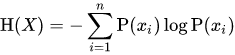

where P(xi) = Probability of occurence of xi.

In our case, we will be computing the probability of occurence of the words in a query.

The code below is inspired from https://nbviewer.org/github/SuperCowPowers/data_hacking/blob/master/sql_injection/sql_injection.ipynb. However, this notebook uses character probabilities instead of word probabilities. Entropy with character probabilities did not give good results and hence the code has been modified for word probability entropies.


In [65]:
# Source: https://nbviewer.org/github/SuperCowPowers/data_hacking/blob/master/sql_injection/sql_injection.ipynb

def entropy(s):
    p, l = Counter(s.split()), float(len(s.split()))
    return -sum( count/l * math.log(count/l, 2) for count in p.values())
mod_data['entropy'] = mod_data['small'].apply(entropy)
mod_data['entropy'].head()

0    2.807355
1    3.418296
2    3.987164
3    4.121928
4    3.836592
Name: entropy, dtype: float64

In [66]:
# plotting the distribution of entropy for SQLIA and normal queries

px.violin(mod_data, y='entropy', color='SQLIA', title='Entropy distribution of SQLIA and Normal Queries')

###### Analysis

- Entropy distributions of SQLIA and normal queries are quite different, which makes entropy an excellent feature for our problem
- Entropy has a bi-modal distribution for normal queries
- For SQLIA queries, entropy has a complicated non-Gaussian distribution


### Scattertext visualization

Scattertext is a useful library for visualization of text data with scatter plots. We will be using this tool to check the frequency of query terms in SQLIA and normal queries. The plot is generated and saved as an html file. A screenshot of the plot has also been provided.

We will also fetch the scaled F1-scores for both SQLIA and normal queries. 

In [67]:
if not ((os.path.exists('SQL scatterplot.html') and os.path.exists('term-frequency-f1.csv'))):
    
    mod_data['cat text'] = mod_data['SQLIA'].astype(str) # scattertext works only if category is a string

    # Source: https://spacy.io/universe/project/scattertext
    
    nlp = spacy.load('en_core_web_sm')
    corpus = st.CorpusFromPandas(mod_data,
                                 category_col='cat text',
                                 text_col='query_proc',
                                 nlp=nlp).build()

    sent = st.produce_scattertext_explorer(corpus, category='True', category_name='SQLIA', not_category_name='Normal', 
                                           width_in_pixels=1000, max_terms=100)

    open("SQL scatterplot.html", 'wb').write(sent.encode('utf-8'))
    
    
    # Source: https://towardsdatascience.com/a-complete-exploratory-data-analysis-and-visualization-for-text-data-29fb1b96fb6a
    
    
    term_freq_df = corpus.get_term_freq_df() # frequency of terms
    term_freq_df['f-score SQLIA'] = corpus.get_scaled_f_scores('True') # scaled F-scores of each term for SQLIA queries
    term_freq_df['f-score Normal'] = corpus.get_scaled_f_scores('False') # scaled F-scores of each term for normal queries
    
    term_freq_df.to_csv('term-frequency-f1.csv') # saving file
    
    mod_data.drop('cat text', axis=1, inplace=True)
else:
    term_freq_df = pd.read_csv('term-frequency-f1.csv', index_col=0) # reading from file

Screenshot of Scatterplot generated:

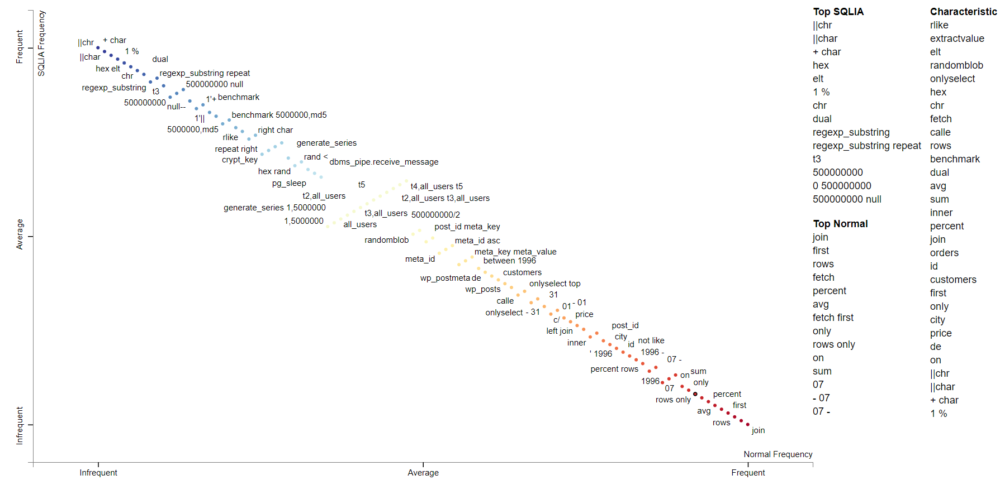

In [68]:
term_freq_df.head()

,True freq,False freq,f-score SQLIA,f-score Normal
term,,,,
or,3568,363,0.993373,0.006627
pg_sleep,238,0,0.934235,0.065765
_,130,67,0.784358,0.215642
time,29,15,0.595955,0.404045
or pg_sleep,12,0,0.571495,0.428505


In [69]:
term_freq_df.sort_values('f-score SQLIA', ascending=False).iloc[:10]

,True freq,False freq,f-score SQLIA,f-score Normal
term,,,,
||char,1992,0,1.0,0.0
char num,3619,0,1.0,0.0
||chr num,5714,0,1.0,0.0
num ||chr,5290,0,1.0,0.0
hex,1553,0,1.0,0.0
+ char,1943,0,1.0,0.0
||chr,5714,0,1.0,0.0
num ||char,1974,0,1.0,0.0
num else,1496,0,1.0,0.0


In [70]:
term_freq_df.sort_values('f-score Normal', ascending=False).iloc[:10]

,True freq,False freq,f-score SQLIA,f-score Normal
term,,,,
first,0,864,0.0,1.0
percent,0,754,0.0,1.0
num percent,0,738,0.0,1.0
rows only,0,630,0.0,1.0
avg,0,751,0.0,1.0
select avg,0,751,0.0,1.0
only,0,642,0.0,1.0
rows,0,847,0.0,1.0
first num,0,842,0.0,1.0


###### Analysis

- For each term, we have an F-score corresponding to SQLIA and normal queries. The presence of terms with high F-scores can be good indicators of a query being SQLIA.
- The scatterplot indicates the frequencies of only 100 tokens. Having all the tokens did not provide any meaningful information. Nevertheless, we can clearly spot the tokens which are more 'SQLIA-like' and others which are more likely to be in normal queries.

### Word Embeddings

Word Embeddings are fixed-length vector representation of words. There already exists many models pretrained on a variety of datasets which create high quality embeddings such as word2vec and glove vectors.
Such vector representations of words are extremely powerful as they capture the semantic meaning of words. They can understand word relatiionships like synonyms, antonyms and comparisons. 

E.g. 
- king - man + women = queen (gender-royalty relationship), 
- France - Paris + Russia = Moscow (country-capital relationship)

Here we will be using glove vectors which is trained on Wikipedia data, which represents each word as a 50-element vector. We will be summing up the word vectors for all words in a query to get a query vector.

Using these word vectors, we can train machine learning models.

In [72]:
# generating the query vectors

vec_len = 50 # vector length
def get_doc_vec(q):
    
    '''
    This function returns a query's embedding by summing up the vectors for each word.
    Parameter q: (str) Query string whose vector embedding is required
    Returns doc_vec: (numpy array) Vector embedding of given query
    '''
    doc_vec = np.zeros(vec_len)
    for w in q.split():
        if glove_vectors.has_index_for(w):
            doc_vec += glove_vectors.get_vector(w)
    return doc_vec

(30905, 50)

In [71]:
# Source: https://radimrehurek.com/gensim/models/word2vec.html#pretrained-models

if os.path.isfile('EDA_query_vectors_glove.csv'):
    doc_vecs = pd.read_csv('EDA_query_vectors_glove.csv', index_col=0)
else:
    glove_vectors = gensim.downloader.load('glove-wiki-gigaword-50') # loading the glove vectors
    doc_vecs = np.zeros((mod_data.shape[0], vec_len))
    for i in range(mod_data.shape[0]):
        q = mod_data.iloc[i]['small']
        doc_vec = get_doc_vec(q)
        doc_vecs[i] = doc_vec

doc_vecs = pd.DataFrame(doc_vecs, index=mod_data.index)

doc_vecs.shape

We can verify whether these query vectors are meaningful or not by plotting them. For that, we will be using T-SNE to reduce the 50-dimensional dataset to 2-dimensions.

### TSNE visualization of word embeddings

We will be working with perplexity values of 50, 30, 18 and 5 to figure out which one gives a better representation.

##### Perplexity = 50

In [73]:
p = 50
filename = 'tsne_p' + str(p) + '.csv'
if os.path.exists(filename):
    tsne_df_50 = pd.read_csv(filename, index_col=0)
else:

    X_embedded = TSNE(n_components=2, perplexity=p, init='random', random_state=0).fit_transform(np.array(doc_vecs))

    tsne_df_50 = pd.DataFrame(X_embedded, columns=['dim1', 'dim2'], index=mod_data.index)
    tsne_df_50['SQLIA'] = mod_data['SQLIA']
    tsne_df_50['index'] = tsne_df_50.index
    tsne_df_50.to_csv(filename)

In [74]:
px.scatter(tsne_df_50, x='dim1', y='dim2', color='SQLIA', hover_name='index', title='2D Representation of Query Vectors')

The data is forming many different clusters. The normal queries are making bigger clusters in general, compared to SQLIA queries. Let's see if we can get a better representation with different perplexities.


##### Perplexity = 30 (default)

In [75]:
p = 30
filename = 'tsne_p' + str(p) + '.csv'
if os.path.exists(filename):
    tsne_df_30 = pd.read_csv(filename, index_col=0)
else:
    X_embedded = TSNE(n_components=2, perplexity=p, init='random', random_state=0).fit_transform(np.array(doc_vecs))
    tsne_df_30 = pd.DataFrame(X_embedded, columns=['dim1', 'dim2'], index=mod_data.index)
    tsne_df_30['SQLIA'] = mod_data['SQLIA']
    tsne_df_30['index'] = tsne_df_30.index
    tsne_df_30.to_csv(filename)

In [76]:
px.scatter(tsne_df_30, x='dim1', y='dim2', color='SQLIA', hover_name='index', title='2D Representation of Query Vectors')

##### Perplexity = 18

In [77]:
p = 18
filename = 'tsne_p' + str(p) + '.csv'
if os.path.exists(filename):
    tsne_df_18 = pd.read_csv(filename, index_col=0)
else:
    X_embedded = TSNE(n_components=2, perplexity=p, init='random', random_state=0).fit_transform(np.array(doc_vecs))
    tsne_df_18 = pd.DataFrame(X_embedded, columns=['dim1', 'dim2'], index=mod_data.index)
    tsne_df_18['SQLIA'] = mod_data['SQLIA']
    tsne_df_18['index'] = tsne_df_18.index
    tsne_df_18.to_csv(filename)

In [78]:
px.scatter(tsne_df_18, x='dim1', y='dim2', color='SQLIA', hover_name='index', title='2D Representation of Query Vectors')

##### Perplexity = 5

In [79]:
p = 5
filename = 'tsne_p' + str(p) + '.csv'
if os.path.exists(filename):
    tsne_df_5 = pd.read_csv(filename, index_col=0)
else:
    X_embedded = TSNE(n_components=2, perplexity=p, init='random', random_state=0).fit_transform(np.array(doc_vecs))
    tsne_df_5 = pd.DataFrame(X_embedded, columns=['dim1', 'dim2'], index=mod_data.index)
    tsne_df_5['SQLIA'] = mod_data['SQLIA']
    tsne_df_5['index'] = tsne_df_5.index
    tsne_df_5.to_csv(filename)

In [80]:
px.scatter(tsne_df_5, x='dim1', y='dim2', color='SQLIA', hover_name='index', title='2D Representation of Query Vectors')

As we can see, there are some clusters forming. Let's look at one of these clusters to see if they make sense.

In [81]:
normal_cluster_indices = [22589, 24260, 25834, 20612, 24180]
sqlia_cluster_indices = [7169, 10007, 9772, 3627, 7271]

mod_data.loc[normal_cluster_indices]['Query']

22589    SELECT AVG ( mile ) FROM outer SELECT SUM ( fi...
24260    SELECT AVG ( experiment ) FROM remain SELECT S...
25834    SELECT AVG ( harbor ) FROM examine SELECT SUM ...
20612    SELECT AVG ( mixture )  FROM raw  SELECT SUM (...
24180    SELECT AVG ( motor ) FROM silence SELECT SUM (...
Name: Query, dtype: object

In [82]:
mod_data.loc[sqlia_cluster_indices]['Query']

7169     call regexp_substring  (  repeat  (  left  (  ...
10007    call regexp_substring  (  repeat  (  left  (  ...
9772     call regexp_substring  (  repeat  (  left  (  ...
3627     call regexp_substring  (  repeat  (  left  (  ...
7271     call regexp_substring  (  repeat  (  left  (  ...
Name: Query, dtype: object

###### Analysis

- The word embeddings help us capture queries that have a similar structure. Knowing the structure of these queries can give us an insight into their meaning and intention, which could indicate whether they are normal or injections.
- We are getting better clusters for normal queries than SQLIAs
- The plot with perplexity of 5 provides a better seperation between the overall structures of SQLIA and normal queries. However, the plot with perplexity=50 provides a better seperation between the clusters.
- Since we have reduced 50 dimensional vectors to 2 dimensions, there is significant loss of information. Using all the 50 dimensions for training our models may provide better results.

### TF-IDF Embeddings with TSNE visualization

The terms TF and IDF are defined as follows:
- Term Frequency, TF(term, document): frequency of the term in the document (captures the importance of the term in the document)
- Inverse Document Frequency, IDF(term, corpus): rarity of the term in the corpus of all documents (captures the rarity/specialty of the term overall)


The TF-IDF score is given for each term as:

TF-IDF(term, document) = TF(term, document) * IDF(term, corpus)

Thus the TF-IDF scores for all the terms in a document are concatenated to give us an embedding for that document. We will see if we can get a better understanding of our dataset using these embeddings.


In [83]:
# Source: https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html

vectorizer = TfidfVectorizer(min_df=50)
X = vectorizer.fit_transform(mod_data['query_proc'])

In [84]:
vec_features = vectorizer.get_feature_names() # get list of all N-grams generated
tfidf_embed = pd.DataFrame(X.toarray(), columns=vec_features, index=mod_data.index) # create DataFrame of token counts
print(vec_features[:50])

['abcdefg', 'all', 'all_users', 'analyse', 'and', 'as', 'asc', 'avg', 'benchmark', 'between', 'boolean', 'by', 'call', 'calle', 'case', 'cast', 'char', 'character_sets', 'chr', 'city', 'collations', 'column_name', 'columns', 'com', 'concat', 'convert', 'count', 'country', 'crypt_key', 'ctxsys', 'customername', 'customers', 'database', 'db', 'dbms_pipe', 'dbms_utility', 'de', 'del', 'delay', 'delete', 'desc', 'distinct', 'domain', 'domains', 'drithsx', 'drop', 'dual', 'else', 'elt', 'employeeid']


We will observe the 2D visualization of these embeddings using TSNE for dimensionality reduction.

In [85]:
p = 50
filename = 'tfidf_tsne_p' + str(p) + '.csv'
if os.path.exists(filename):
    tsne_df_50 = pd.read_csv(filename, index_col=0)
else:

    X_embedded = TSNE(n_components=2, perplexity=p, init='random', random_state=0).fit_transform(np.array(tfidf_embed))

    tsne_df_50 = pd.DataFrame(X_embedded, columns=['dim1', 'dim2'], index=mod_data.index)
    tsne_df_50['SQLIA'] = mod_data['SQLIA']
    tsne_df_50['index'] = tsne_df_50.index
    tsne_df_50.to_csv(filename)

In [86]:
px.scatter(tsne_df_50, x='dim1', y='dim2', color='SQLIA', hover_name='index', title='2D Representation of Query Vectors')

###### TFIDF - Perplexity = 30 (default)

In [87]:
p = 30
filename = 'tfidf_tsne_p' + str(p) + '.csv'
if os.path.exists(filename):
    tsne_df_30 = pd.read_csv(filename, index_col=0)
else:
    X_embedded = TSNE(n_components=2, perplexity=p, init='random', random_state=0).fit_transform(np.array(tfidf_embed))
    tsne_df_30 = pd.DataFrame(X_embedded, columns=['dim1', 'dim2'], index=mod_data.index)
    tsne_df_30['SQLIA'] = mod_data['SQLIA']
    tsne_df_30['index'] = tsne_df_30.index
    tsne_df_30.to_csv(filename)

In [88]:
px.scatter(tsne_df_30, x='dim1', y='dim2', color='SQLIA', hover_name='index', title='2D Representation of Query Vectors')

###### TFIDF - Perplexity = 18

In [89]:
p = 18
filename = 'tfidf_tsne_p' + str(p) + '.csv'
if os.path.exists(filename):
    tsne_df_18 = pd.read_csv(filename, index_col=0)
else:
    X_embedded = TSNE(n_components=2, perplexity=p, init='random', random_state=0).fit_transform(np.array(tfidf_embed))
    tsne_df_18 = pd.DataFrame(X_embedded, columns=['dim1', 'dim2'], index=mod_data.index)
    tsne_df_18['SQLIA'] = mod_data['SQLIA']
    tsne_df_18['index'] = tsne_df_18.index
    tsne_df_18.to_csv(filename)

In [90]:
px.scatter(tsne_df_18, x='dim1', y='dim2', color='SQLIA', hover_name='index', title='2D Representation of Query Vectors')

###### TFIDF - Perplexity = 5

In [91]:
p = 5
filename = 'tfidf_tsne_p' + str(p) + '.csv'
if os.path.exists(filename):
    tsne_df_5 = pd.read_csv(filename, index_col=0)
else:
    X_embedded = TSNE(n_components=2, perplexity=p, init='random', random_state=0).fit_transform(np.array(tfidf_embed))
    tsne_df_5 = pd.DataFrame(X_embedded, columns=['dim1', 'dim2'], index=mod_data.index)
    tsne_df_5['SQLIA'] = mod_data['SQLIA']
    tsne_df_5['index'] = tsne_df_5.index
    tsne_df_5.to_csv(filename)

In [92]:
px.scatter(tsne_df_5, x='dim1', y='dim2', color='SQLIA', hover_name='index', title='2D Representation of Query Vectors')

###### Analysis

- From the above plots we can see that there are many different clusters forming, instead of 2 clusters for SQLIA and normal queries. This is expected because we are only using 2 dimensions here. Classifying queries would require a lot more dimensions.
- We will look at some of the points from 1 cluster in the plot we got for perplexity=5.

In [93]:
normal_cluster_indices = [22617, 26257, 22518, 28225, 27240]
sqlia_cluster_indices = [7385, 9232, 6192, 10570, 8901]

print(mod_data.loc[normal_cluster_indices]['Query'].values)

['   SELECT zero,plenty,dress,temperature,nails     (  (  cotton JOIN where ON opportunity.bag =  similar.grass )   INNER JOIN coatON Orders.caught =  shot.gooseID ) '
 '   SELECT famous,involved,order,someone,shape     (  (  war JOIN shoot ON enough.bigger =  feed.bush )   INNER JOIN shoulderON Orders.park =  someone.upID ) '
 '   SELECT full,trail,oldest,to,zipper     (  (  suddenly JOIN worried ON mood.slipped =  themselves.problem )   INNER JOIN ourselvesON Orders.moment =  give.shorterID ) '
 '   SELECT here,increase,be,ahead,silly     (  (  without JOIN physical ON camp.never =  fog.kept )   INNER JOIN tentON Orders.gray =  union.cageID ) '
 '   SELECT truck,straw,political,worse,involved     (  (  stuck JOIN fed ON practical.relationship =  air.section )   INNER JOIN mirrorON Orders.city =  movement.bentID ) ']


In [94]:
print(mod_data.loc[sqlia_cluster_indices]['Query'].values)

["1' in boolean mode  )   or extractvalue  (  1297,concat  (  0x5c,0x7171706a71,  (  select   (  elt  (  1297  =  1297,1   )    )     )  ,0x717a767a71   )    )   #"
 '1,  (  select 2*  (  if   (    (   select * from   (  select concat  (  0x7171706a71,  (  select   (  elt  (  9693  =  9693,1   )    )     )  ,0x717a767a71,0x78   )    )   s  )  , 8446744073709551610, 8446744073709551610   )    )     )  '
 "1' in boolean mode  )   or exp  (  ~  (  select * from   (  select concat  (  0x7171706a71,  (  select   (  elt  (  6270  =  6270,1   )    )     )  ,0x717a767a71,0x78   )    )   x   )    )   #"
 '1  )   and   (  select 2*  (  if   (    (   select * from   (  select concat  (  0x7171706a71,  (  select   (  elt  (  3484  =  3484,1   )    )     )  ,0x717a767a71,0x78   )    )   s  )  , 8446744073709551610, 8446744073709551610   )    )     )  '
 '  (  updatexml  (  8862,concat  (  0x2e,0x7171706a71,  (  select   (  elt  (  8862  =  8862,1   )    )     )  ,0x717a767a71  )  ,8981   )    )   '

### Features: PLR and NLR

G-test or likelihood ratio test (LRT) is a useful hypothesis testing technique. The g-score is evaluated as: (https://en.wikipedia.org/wiki/G-test)

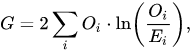

In our case, Oi is the observed frequency, Ei is the expected frequency of a token in a query. The null hypothesis is:


Since we have 2 categories (Normal and SQLIA), we can calculate 2 scores:

1. Positive Likelihood Ratio (PLR): Likelihood of a token belonging to SQLIA queries
2. Negative Likelihood Ratio (NLR): Likelihood of a token belonging to normal queries

The implementation of this likelihood ratio computation has been inspired by:
- https://nbviewer.org/github/SuperCowPowers/data_hacking/blob/master/sql_injection/sql_injection.ipynb
- https://github.com/SuperCowPowers/data_hacking/blob/master/data_hacking/simple_stats/simple_stats.py

First, we need to build the contingency table i.e. a table showing the frequencies of each token in SQLIA and normal queries. For this, we will be using the token_count_df, which we found from the CountVectorizer token counts.

In [95]:
sqlia_count = token_count_df[mod_data['SQLIA']==True].sum(axis=0)
normal_count = token_count_df[mod_data['SQLIA']==False].sum(axis=0)
total_count = token_count_df.sum(axis=0)

# contingency table
cont_table = pd.concat([sqlia_count, normal_count, total_count], axis=1, keys=['SQLIA', 'Normal', 'Total'])
cont_table.head()

,SQLIA,Normal,Total
__time__,37,0,37
abcdefg,223,0,223
abcdefg upper,223,0,223
above,0,27,27
accurate,0,26,26


The above values are the actual/observed counts. We calculate the expected count of a token t as:

In [96]:
# we will use num_q to calculate the number of SQLIA queries, normal queries and total queries
num_q = mod_data['SQLIA'].value_counts()
num_q

False    19528
True     11377
Name: SQLIA, dtype: int64

In [97]:
num_normal = num_q[False]
num_sqlia = num_q[True]
num_total = num_normal + num_sqlia

In [98]:
# calculating the expected count of token in both types of queries

cont_table['Expected SQLIA'] = cont_table['SQLIA'] * num_sqlia/num_total
cont_table['Expected Normal'] = cont_table['Normal'] * num_normal/num_total
cont_table.head()

,SQLIA,Normal,Total,Expected SQLIA,Expected Normal
__time__,37,0,37,13.620741,0.000000
abcdefg,223,0,223,82.092574,0.000000
abcdefg upper,223,0,223,82.092574,0.000000
above,0,27,27,0.000000,17.060540
accurate,0,26,26,0.000000,16.428669


In [99]:
# computing PLR and NLR

def get_likelihood_ratio(q_type):
    
    '''
    This function returns the likelihood ratios or g-scores for given query type, based on the contingency table.
    Parameter q_type: (str) Query type. Either 'SQLIA' or 'Normal'
    Returns lr: (numpy.ndarray) Array of g-scores
    '''
    assert (q_type=='SQLIA' or q_type=='Normal')
    lr = np.zeros(token_count_df.shape[1])
    for i in range(token_count_df.shape[1]):
        count = cont_table.iloc[i][q_type]
        exp = cont_table.iloc[i]['Expected ' + q_type]
        if count == 0:
            continue
        elif exp == 0:
            lr[i] = float('inf')
        else:
            lr[i] = 2 * count * math.log(count/exp)
    return lr

cont_table['PLR'] = get_likelihood_ratio('SQLIA')
cont_table['NLR'] = get_likelihood_ratio('Normal')
cont_table.head()

,SQLIA,Normal,Total,Expected SQLIA,Expected Normal,PLR,NLR
__time__,37,0,37,13.620741,0.000000,73.949992,0.000000
abcdefg,223,0,223,82.092574,0.000000,445.698597,0.000000
abcdefg upper,223,0,223,82.092574,0.000000,445.698597,0.000000
above,0,27,27,0.000000,17.060540,0.000000,24.789707
accurate,0,26,26,0.000000,16.428669,0.000000,23.871570


In [100]:
# top 5 PLR tokens

cont_table.sort_values(by='PLR', ascending=False).head(5)

,SQLIA,Normal,Total,Expected SQLIA,Expected Normal,PLR,NLR
num,72446,12819,85265,26669.410840,8099.965442,144794.083371,11769.602049
num num,24459,4124,28583,9004.046044,2605.839573,48884.941683,3786.398225
select,10009,12883,22892,3684.594499,8140.405242,20004.472027,11828.362836
chr,6588,0,6588,2425.228151,0.000000,13167.095785,0.000000
chr num,6588,0,6588,2425.228151,0.000000,13167.095785,0.000000


In [101]:
# top 5 NLR tokens

ct = cont_table.sort_values(by='NLR')
ct.head()

,SQLIA,Normal,Total,Expected SQLIA,Expected Normal,PLR,NLR
__time__,37,0,37,13.620741,0.0,73.949992,0.0
num sgvo,55,0,55,20.247047,0.0,109.925663,0.0
num sleep,187,0,187,68.839961,0.0,373.747254,0.0
num srmq,38,0,38,13.988869,0.0,75.948640,0.0
num sysibm,446,0,446,164.185148,0.0,891.397195,0.0


We can see that most of the top tokens are those that have high values for both PLR and NLR. Such values are not useful for us as they do not indicate whether their presence increases or decreases the chance of the query being SQLIA.

Let's plot the NLR vs PLR scatter plot to visualize which datapoints are necessary for us and which can be excluded

In [102]:
# Plotting PLR vs NLR for all tokens

px.scatter(ct.iloc[:-5], x='NLR', y='PLR', title='PLR vs NLR Scatter Plot of tokens')

###### Analysis:

1. Most points are in the range NLR:0-200 and PLR:0-4000
2. There are some points which have very high PLR and low NLR and vice versa. Such points are crucial towards indicating whether a query is SQLIA or not.
3. Points which have high PLR and high NLR, or alternatively, low PLR and low NLR are not important and they must be removed from our set of tokens.
4. We need to further investigate to remove the unwanted tokens and bring forth the important tokens.

In order to remove the unwanted tokens, we will first convert the PLR and NLR scores to percentiles. The tokens which have high PLR and NLR percentiles or low PLR and NLR percentiles will be removed.


In [103]:
# computing percentiles of PLR and NLR scores

cont_table['PLR_percentile'] = [percentileofscore(cont_table['PLR'].values, i) for i in cont_table['PLR'].values]
cont_table['NLR_percentile'] = [percentileofscore(cont_table['NLR'].values, i) for i in cont_table['NLR'].values]
cont_table.head()

,SQLIA,Normal,Total,Expected SQLIA,Expected Normal,PLR,NLR,PLR_percentile,NLR_percentile
__time__,37,0,37,13.620741,0.000000,73.949992,0.000000,69.533898,11.483051
abcdefg,223,0,223,82.092574,0.000000,445.698597,0.000000,86.610169,11.483051
abcdefg upper,223,0,223,82.092574,0.000000,445.698597,0.000000,86.610169,11.483051
above,0,27,27,0.000000,17.060540,0.000000,24.789707,32.245763,78.177966
accurate,0,26,26,0.000000,16.428669,0.000000,23.871570,32.245763,75.720339


In [104]:
# Tokens with percentiles above 75 and below 25 for both PLR and NLR will not be considered for analysis.

high = 75
low = 25
invalid_tokens = []
for i in range(cont_table.shape[0]):
    p = cont_table.iloc[i]['PLR_percentile']
    n = cont_table.iloc[i]['NLR_percentile']
    if (min(p, n) > high) or (max(p, n) < low):
        invalid_tokens.append(cont_table.index[i])

cont_table_mod = cont_table.drop(index=invalid_tokens)

Let's get the top 20 tokens by PLR and NLR

In [105]:
def get_top_N_tokens(col, N):
    
    '''
    This function returns the 'N' tokens having highest value of 'col'
    Parameter col: (str) positive or negative likelihood ratio. Permitted values: 'PLR', 'NLR'
    Parameter N: (int) number of top tokens to return
    Returns a numpy array of top tokens
    '''
    assert (col=='PLR' or col=='NLR')
    return np.array(cont_table_mod.sort_values(by=col, ascending=False).index[:N])

top_10_sqli_tokens = get_top_N_tokens('PLR', 10)
top_10_normal_tokens = get_top_N_tokens('NLR', 10)

Let's check if we have got the right tokens by visualizing them using a scatterplot.

In [106]:
# Plotting the top 20 tokens in a PLR vs NLR scatterplot
tokens = np.concatenate((top_10_sqli_tokens, top_10_normal_tokens))
px.scatter(x=cont_table.loc[tokens]['NLR'], y=cont_table.loc[tokens]['PLR'], hover_name=tokens, title='PLR vs NLR: Top 20 tokens')

In [107]:
print('SQLIA tokens:', top_10_sqli_tokens)
print('Normal tokens:', top_10_normal_tokens)

SQLIA tokens: ['chr num' 'chr' 'char' 'char num' 'num chr' 'num char' 'null null'
 'num or' 'select num' 'num union']
Normal tokens: ['not' 'join' 'top' 'top num' 'between' 'first' 'rows' 'first num' 'fetch'
 'fetch first']


###### Analysis:

1. As seen from the plot, the top values are either high in PLR or high in NLR, but not both. This aligns with our expectations.
2. We can see differentiating patterns in SQLIA tokens and normal tokens. These can be used by our machine learning models as important features for detection.

## Conclusion

- We have experimented with lot of features and visualizations to understand our dataset better
- We have processed the queries by lower casing, finding numeric, hexadecimal tokens.
- We have come up with features that could be useful in classifying SQLIAs from normal queries. These features are:
 - always_true
 - has_keywords
 - is_complete_query
 - one_word
 - entropy
- We have also applied several techniques to find tokens whose presence in a query can indicate if it is SQLIA or not.
 - token counts using CountVectorizer
 - POS tags for tokens
 - Likelihood ratios
- We have also computed vector embeddings which could be useful for training ML models
- We have created several types of plots to visualize the relation between the features and the labels.
 - Scattertext plot
 - Violin plot
 - Histogram
 - Scatter plot
 - Heatmap

In [109]:
# Saving variables to disk
input("Save variables to disk? ")
mod_data.to_csv('EDA_processed_data.csv')
cont_table.to_csv('EDA_contingency_table.csv')
doc_vecs.to_csv('EDA_query_vectors_glove.csv')
term_freq_df.to_csv('EDA_term_frequency_fscores.csv')
with open('invalid_tokens.txt', 'w') as f:
    f.write(json.dumps(invalid_tokens))

Save variables to disk? y
